In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import jinja2
from dataprep.eda import create_report, plot, plot_correlation, plot_missing , plot_diff
from sklearn.metrics import confusion_matrix, precision_score, recall_score
from sklearn.linear_model import LinearRegression, LogisticRegression

In [2]:
df = pd.read_csv('train.csv')
df.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
0,0001_01,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False
1,0002_01,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True
2,0003_01,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False
3,0003_02,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False
4,0004_01,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8693 entries, 0 to 8692
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   PassengerId   8693 non-null   object 
 1   HomePlanet    8492 non-null   object 
 2   CryoSleep     8476 non-null   object 
 3   Cabin         8494 non-null   object 
 4   Destination   8511 non-null   object 
 5   Age           8514 non-null   float64
 6   VIP           8490 non-null   object 
 7   RoomService   8512 non-null   float64
 8   FoodCourt     8510 non-null   float64
 9   ShoppingMall  8485 non-null   float64
 10  Spa           8510 non-null   float64
 11  VRDeck        8505 non-null   float64
 12  Name          8493 non-null   object 
 13  Transported   8693 non-null   bool   
dtypes: bool(1), float64(6), object(7)
memory usage: 891.5+ KB


  0%|          | 0/1901 [00:00<?, ?it/s]

c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({c


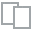
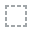
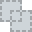
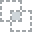
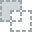
...
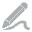
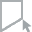
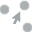
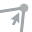
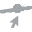

In [5]:
report = create_report(df)
report.show()


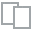
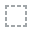
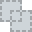
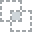
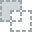
...
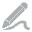
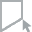
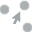
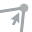
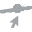

In [6]:
plot_correlation(df)

In [10]:
df.isnull().sum()

PassengerId       0
HomePlanet      201
CryoSleep       217
Cabin           199
Destination     182
Age             179
VIP             203
RoomService     181
FoodCourt       183
ShoppingMall    208
Spa             183
VRDeck          188
Name            200
Transported       0
dtype: int64

Feature Engineering - borrowed

In [7]:
expense_features = ['RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck']

In [28]:
def age_group(df):
    age_group = pd.cut(x=df.Age.astype(float),
                      bins=[-1, 12, 18, 25, 30, 50, 1.e+10],
                      labels=['Age_0-12', 'Age_13-17', 'Age_18-25', 'Age_26-30', 'Age_31-50', 'Age_51+'])
    if 'Age_Group' in df.columns:
        df = df.drop('Age_Group', axis=1)
        df.insert(df.shape[1],'Age_Group', age_group)
    else:
        df.insert(df.shape[1],'Age_Group', age_group)
    return df


def expense(df):
    df['Total_expense'] = df.loc[:,expense_features].sum(axis=1)
    df['No_expenses'] = (df['Total_expense']==0).astype(int)
    return df


def passengerid_extracting_data(df):
    df.loc[:,['GroupId']] = df.PassengerId.str.split("_",expand=True).iloc[:,0]
    df.loc[:,['MemberId']] = df.PassengerId.str.split("_",expand=True).iloc[:,1]
    return df


def group_size(df):
    df['Group_size']=df['GroupId'].map(lambda x: df['GroupId'].value_counts()[x])
    df['Solo']=(df['Group_size']==1).astype(int)
    return df


def cabin_extracting_data(df):
    df.loc[:,['Deck']] = df.Cabin.str.split("/",expand=True).iloc[:,0]
    df.loc[:,['Num']] = df.Cabin.str.split("/",expand=True).iloc[:,1]
    df.Num = df.Num.str.strip()
    df.Num = df.Num.astype('float').astype('Int64')
    df.loc[:,['Side']] = df.Cabin.str.split("/",expand=True).iloc[:,2]
    return df


def cabin_region(df):
    cabin_group = pd.cut(x=df.Num.astype('float'),
                      bins=[-10, 300, 600, 900, 1200, 1500, 1800, 1.e+10],
                      labels=['Cab_r_1', 'Cab_r_2', 'Cab_r_3', 'Cab_r_4', 'Cab_r_5', 'Cab_r_6', 'Cab_r_7'])
    if 'Cabin_Region' in df.columns:
        df = df.drop('Cabin_Region', axis=1)
        df.insert(df.shape[1],'Cabin_Region', cabin_group)
    else:
        df.insert(df.shape[1],'Cabin_Region', cabin_group)
    return df


def surname(df):
    df['Name'].fillna('Unknown Unknown', inplace=True)
    df['Surname'] = df['Name'].str.split(expand=True)[1]
    return df


def family_size(df):
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    return df

# def family_size(df):
#     df['Family_size'] = df.groupby(['GroupId', 'Surname', 'HomePlanet'])['PassengerId'].transform('size')
#     return df

In [29]:
df = age_group(df)
df = expense(df)
df = passengerid_extracting_data(df)
df = group_size(df)
df = cabin_extracting_data(df)
df = cabin_region(df)
df = surname(df)
df = family_size(df)

In [30]:
df.Family_size.value_counts()

5      1280
4      1280
3      1164
6      1038
7       833
2       800
8       544
1       382
9       315
10      300
11      275
200     200
12       84
13       78
14       56
15       30
18       18
16       16
Name: Family_size, dtype: int64

In [31]:
def hp_groupid(df):
    GHP_gb=df.groupby(['GroupId','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    ghp_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['GroupId']).isin(GHP_gb.index)].index
    df.loc[ghp_index,'HomePlanet']=df.iloc[ghp_index,:]['GroupId'].map(lambda x: GHP_gb.idxmax(axis=1)[x])
    return df


def hp_deck(df):
    CDHP_gb=df.groupby(['Deck','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    df.loc[(df['HomePlanet'].isna()) & (df['Deck'].isin(['A', 'B', 'C', 'T'])), 'HomePlanet']='Europa'
    df.loc[(df['HomePlanet'].isna()) & (df['Deck']=='G'), 'HomePlanet']='Earth'
    return df


def hp_surname(df):
    SHP_gb=df.groupby(['Surname','HomePlanet'])['HomePlanet'].size().unstack().fillna(0)
    SHP_index=df[df['HomePlanet'].isna()][(df[df['HomePlanet'].isna()]['Surname']).isin(SHP_gb.index)].index
    df.loc[SHP_index,'HomePlanet']=df.iloc[SHP_index,:]['Surname'].map(lambda x: SHP_gb.idxmax(axis=1)[x])
    return df


def hp_destination(df):
    HPD_gb=df.groupby(['HomePlanet','Destination'])['Destination'].size().unstack().fillna(0)
    df.loc[(df['HomePlanet'].isna()) & ~(df['Deck']=='D'), 'HomePlanet']='Earth'
    df.loc[(df['HomePlanet'].isna()) & (df['Deck']=='D'), 'HomePlanet']='Mars'
    return df


def destination(df):
    df.loc[(df['Destination'].isna()), 'Destination']='TRAPPIST-1e'
    return df


def surname_groupid(df):
    GSN_gb=df[df['Group_size']>1].groupby(['GroupId','Surname'])['Surname'].size().unstack().fillna(0)
    GSN_index=df[df['Surname'].isna()][(df[df['Surname'].isna()]['GroupId']).isin(GSN_gb.index)].index
    df.loc[GSN_index,'Surname']=df.iloc[GSN_index,:]['GroupId'].map(lambda x: GSN_gb.idxmax(axis=1)[x])
    return df


def surname_na(df):
    df['Surname'].fillna('Unknown', inplace=True)
    df['Family_size']=df['Surname'].map(lambda x: df['Surname'].value_counts()[x])
    df.loc[df['Surname']=='Unknown','Surname']=np.nan
    df.loc[df['Family_size']>100,'Family_size']=0
    return df


def cabin_side_groupid(df):
    GCD_gb=df[df['Group_size']>1].groupby(['GroupId','Deck'])['Deck'].size().unstack().fillna(0)
    GCN_gb=df[df['Group_size']>1].groupby(['GroupId','Num'])['Num'].size().unstack().fillna(0)
    GCS_gb=df[df['Group_size']>1].groupby(['GroupId','Side'])['Side'].size().unstack().fillna(0)
    GCS_index=df[df['Side'].isna()][(df[df['Side'].isna()]['GroupId']).isin(GCS_gb.index)].index
    df.loc[GCS_index,'Side']=df.iloc[GCS_index,:]['GroupId'].map(lambda x: GCS_gb.idxmax(axis=1)[x])
    return df


def cabin_side_surname(df):
    SCS_gb=df[df['Group_size']>1].groupby(['Surname','Side'])['Side'].size().unstack().fillna(0)
    SCS_gb['Ratio']=SCS_gb['P']/(SCS_gb['P']+SCS_gb['S'])
    SCS_gb.drop('Ratio', axis=1, inplace=True)
    SCS_index=df[df['Side'].isna()][(df[df['Side'].isna()]['Surname']).isin(SCS_gb.index)].index
    df.loc[SCS_index,'Side']=df.iloc[SCS_index,:]['Surname'].map(lambda x: SCS_gb.idxmax(axis=1)[x])
    return df


def cabin_side(df):
    df.loc[df['Side'].isna(),'Side']='Z'
    return df


def deck_groupid(df):
    GCD_gb=df[df['Group_size']>1].groupby(['GroupId','Deck'])['Deck'].size().unstack().fillna(0)
    GCD_index=df[df['Deck'].isna()][(df[df['Deck'].isna()]['GroupId']).isin(GCD_gb.index)].index
    df.loc[GCD_index,'Deck']=df.iloc[GCD_index,:]['GroupId'].map(lambda x: GCD_gb.idxmax(axis=1)[x])
    return df


def deck_other(df):
    CD_bef=df['Deck'].isna().sum()
    na_rows_CD=df.loc[df['Deck'].isna(),'Deck'].index
    df.loc[df['Deck'].isna(),'Deck']=df.groupby(['HomePlanet','Destination','Solo'])['Deck'].transform(lambda x: x.fillna(pd.Series.mode(x)[0]))[na_rows_CD]
    return df


def num_linear(df):
    preds_CN_all = []
    for deck in ['A', 'B', 'C', 'D', 'E', 'F', 'G']:
        # Features and labels
        X_CN=df.loc[~(df['Num'].isna()) & (df['Deck']==deck),'GroupId']
        y_CN=df.loc[~(df['Num'].isna()) & (df['Deck']==deck),'Num']
        X_test_CN=df.loc[(df['Num'].isna()) & (df['Deck']==deck),'GroupId']

        # Linear regression
        model_CN=LinearRegression()
        model_CN.fit(X_CN.values.reshape(-1, 1), y_CN)
        preds_CN=model_CN.predict(X_test_CN.values.reshape(-1, 1))

        # Fill missing values with predictions
        df.loc[(df['Num'].isna()) & (df['Deck']==deck),'Num']=preds_CN.astype(int)
    return df


def vip(df):
    df.loc[df['VIP'].isna(),'VIP']=False
    return df


def age(df):
    na_rows_A=df.loc[df['Age'].isna(),'Age'].index
    df.loc[df['Age'].isna(),'Age']=df.groupby(['HomePlanet','No_expenses','Solo','Deck'])['Age'].transform(lambda x: x.fillna(x.median()))[na_rows_A]
    return df


def cryosleep(df):
    na_rows_CSL=df.loc[df['CryoSleep'].isna(),'CryoSleep'].index
    df.loc[df['CryoSleep'].isna(),'CryoSleep']=df.groupby(['No_expenses'])['CryoSleep'].transform(lambda x: x.fillna(pd.Series.mode(x)[0]))[na_rows_CSL]
    return df


def expense_features_na(df):
    for col in expense_features:
        df.loc[(df[col].isna()) & (df['CryoSleep']==True), col]=0
    for col in expense_features:
        na_rows=df.loc[df[col].isna(),col].index
        df.loc[df[col].isna(),col]=df.groupby(['HomePlanet','Solo','Age_Group'])[col].transform(lambda x: x.fillna(x.mean()))[na_rows]
    return df

In [32]:
df = hp_groupid(df)
df = hp_deck(df)
df = hp_surname(df)
df = hp_destination(df)
df = destination(df)
df = surname_groupid(df)
df = surname_na(df)
df = cabin_side_groupid(df)
df = cabin_side_surname(df)
df = cabin_side(df)
df = deck_groupid(df)
df = deck_other(df)
df = num_linear(df)
df = cabin_region(df)
df = vip(df)
df = age(df)
df = age_group(df)
df = cryosleep(df)
df = expense_features_na(df)
df = expense(df)

In [36]:
df.isnull().sum()

PassengerId        0
HomePlanet         0
CryoSleep          0
Cabin            199
Destination        0
Age                0
VIP                0
RoomService        0
FoodCourt          0
ShoppingMall       0
Spa                0
VRDeck             0
Name               0
Transported        0
Total_expense      0
No_expenses        0
GroupId            0
MemberId           0
Group_size         0
Solo               0
Deck               0
Num                0
Side               0
Surname          200
Family_size        0
Cabin_Region       0
Age_Group          0
dtype: int64

In [37]:
numerical_cols = ['Age', 'RoomService', 'FoodCourt', 'ShoppingMall', 'Spa', 'VRDeck', 'Total_expense', 'No_expenses', 'Solo', 'Family_size']
categorical_cols = ['HomePlanet', 'CryoSleep', 'Destination', 'VIP', 'Deck', 'Side', 'Cabin_Region']
target_col = 'Transported'

In [38]:
print("Before Dropping: ",df.shape)
# create a set of all columns in the dataset
all_cols = set(df.columns)

# create a set of columns to keep
keep_cols = set(numerical_cols + categorical_cols + [target_col])

# create a set of columns to drop
drop_cols = all_cols - keep_cols

# drop the columns not in the keep_cols set
df = df.drop(columns=drop_cols)
print("After Dropping: ",df.shape)

Before Dropping:  (8693, 27)
After Dropping:  (8693, 18)


In [39]:
df.head()

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Transported,Total_expense,No_expenses,Solo,Deck,Side,Family_size,Cabin_Region
0,Europa,False,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,False,0.0,1,1,B,P,1,Cab_r_1
1,Earth,False,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,True,736.0,0,1,F,S,4,Cab_r_1
2,Europa,False,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,False,10383.0,0,0,A,S,6,Cab_r_1
3,Europa,False,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,False,5176.0,0,0,A,S,6,Cab_r_1
4,Earth,False,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,True,1091.0,0,1,F,S,6,Cab_r_1


In [40]:
df1 = pd.get_dummies(data = df, drop_first=True, columns=categorical_cols)
df.shape, df1.shape

((8693, 18), (8693, 36))

Modeling

In [41]:
X = df1.drop(target_col,axis=1)
y = df1[target_col]
X.shape, y.shape

((8693, 35), (8693,))

In [42]:
y.value_counts()

True     4378
False    4315
Name: Transported, dtype: int64

In [43]:
# create X and Y datasets for training
from sklearn import model_selection
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y,stratify=y, random_state=42, test_size = 0.2)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((6954, 35), (1739, 35), (6954,), (1739,))

Logreg

In [44]:
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='liblinear', random_state=0)


# fit the model
logreg.fit(X_train, y_train)

LogisticRegression(random_state=0, solver='liblinear')

In [45]:
print('Training set score: {:.4f}'.format(logreg.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(logreg.score(X_test, y_test)))

Training set score: 0.7982
Test set score: 0.7987


In [46]:
from sklearn.model_selection import GridSearchCV

from sklearn.neighbors import KNeighborsClassifier
#In case of classifier like knn the parameter to be tuned is n_neighbors
param_grid = {'n_neighbors':np.arange(1,50)}
knn = KNeighborsClassifier()
knn_cv= GridSearchCV(knn,param_grid,verbose=10,cv=3)
knn_cv.fit(X_train,y_train)

print("Best Score:" + str(knn_cv.best_score_))
print("Best Parameters: " + str(knn_cv.best_params_))

Fitting 3 folds for each of 49 candidates, totalling 147 fits
[CV 1/3; 1/49] START n_neighbors=1..............................................
[CV 1/3; 1/49] END ...............n_neighbors=1;, score=0.736 total time=   0.0s
[CV 2/3; 1/49] START n_neighbors=1..............................................
[CV 2/3; 1/49] END ...............n_neighbors=1;, score=0.723 total time=   0.0s
[CV 3/3; 1/49] START n_neighbors=1..............................................
[CV 3/3; 1/49] END ...............n_neighbors=1;, score=0.723 total time=   0.0s
[CV 1/3; 2/49] START n_neighbors=2..............................................
[CV 1/3; 2/49] END ...............n_neighbors=2;, score=0.740 total time=   0.0s
[CV 2/3; 2/49] START n_neighbors=2..............................................
[CV 2/3; 2/49] END ...............n_neighbors=2;, score=0.726 total time=   0.0s
[CV 3/3; 2/49] START n_neighbors=2..............................................
[CV 3/3; 2/49] END ...............n_neighbors=2

In [47]:
print('Training set score: {:.4f}'.format(knn_cv.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(knn_cv.score(X_test, y_test)))

Training set score: 0.7936
Test set score: 0.7918


Random Forests

In [48]:
# import Random Forest classifier
from sklearn.ensemble import RandomForestClassifier

# instantiate the classifier 
rfc = RandomForestClassifier(random_state=12,n_estimators=10)

# fit the model
rfc.fit(X_train, y_train)

# Predict the Test set results
y_pred = rfc.predict(X_test)

# Check accuracy score 
from sklearn.metrics import accuracy_score

print('Model accuracy score with 10 decision-trees : {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

Model accuracy score with 10 decision-trees : 0.7941


In [49]:
print('Training set score: {:.4f}'.format(rfc.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(rfc.score(X_test, y_test)))

Training set score: 0.9835
Test set score: 0.7941


In [50]:
# import Random Forest classifier
from sklearn.ensemble import RandomForestClassifier

# instantiate the classifier 
rfc_100 = RandomForestClassifier(random_state=12,n_estimators=100)

# fit the model
rfc_100.fit(X_train, y_train)

# Predict the Test set results
y_pred = rfc_100.predict(X_test)

# Check accuracy score 
from sklearn.metrics import accuracy_score

print('Model accuracy score with 100 decision-trees : {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

Model accuracy score with 100 decision-trees : 0.8062


In [51]:
print('Training set score: {:.4f}'.format(rfc_100.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(rfc_100.score(X_test, y_test)))

Training set score: 0.9965
Test set score: 0.8062
